<a href="https://colab.research.google.com/github/Yassaadi/e_commerce/blob/main/Assaadi_Yassine_1_notebook_exploration_112022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#GOOGLE COLAB
from google.colab import drive
drive.mount('/content/drive')
from IPython.display import Image

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#BASIC LIBs
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm

#STAT TOOLS
from math import sqrt
from scipy import stats #BoxCox
import random
from numpy.lib.function_base import percentile
from pandas.core.algorithms import quantile

#GRAPHS
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

#TRANSFORMATION
from sklearn import preprocessing 
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer, PolynomialFeatures
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.preprocessing import OrdinalEncoder

from sklearn.decomposition import PCA

#Classifiers
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.neighbors import NearestNeighbors

#METRICS
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import silhouette_score, silhouette_samples

#DATA SPLITING 
from sklearn.model_selection import cross_val_score, KFold, train_test_split

#IMPUTERS
from sklearn.impute import SimpleImputer, KNNImputer # IterativeImputer

#GRID SEARCH
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

#PIPELINES
from sklearn.pipeline import Pipeline, make_pipeline 

#Columns & rows size
pd.set_option('display.max_rows', None) 
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None) 


#graphs default configuration
plt.rcParams['figure.figsize']=(10,6)
plt.style.use('fivethirtyeight')
%config InlineBackend.figure_formats = ['svg']

# 0. Data loading

In [ ]:
path1= '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_customers_dataset.csv'
path2= '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_orders_dataset.csv'
path3= '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_order_reviews_dataset.csv'
path4= '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_order_payments_dataset.csv'
path5= '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_order_items_dataset.csv'
path6= "/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_products_dataset.csv"
path7= "/content/drive/MyDrive/Colab Notebooks/P5-Ecom /product_category_name_translation.csv"
path8= "/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_sellers_dataset.csv"
path9= "/content/drive/MyDrive/Colab Notebooks/P5-Ecom /olist_geolocation_dataset.csv"

df1 = pd.read_csv(path1,encoding="utf-8")  
df2 = pd.read_csv(path2,encoding="utf-8")
df3 = pd.read_csv(path3,encoding="utf-8")
df4 = pd.read_csv(path4,encoding="utf-8")
df5 = pd.read_csv(path5,encoding="utf-8")
df6 = pd.read_csv(path6,encoding="utf-8")
df7 = pd.read_csv(path7,encoding="utf-8")
df8 = pd.read_csv(path8,encoding="utf-8")
df9 = pd.read_csv(path9,encoding="utf-8")

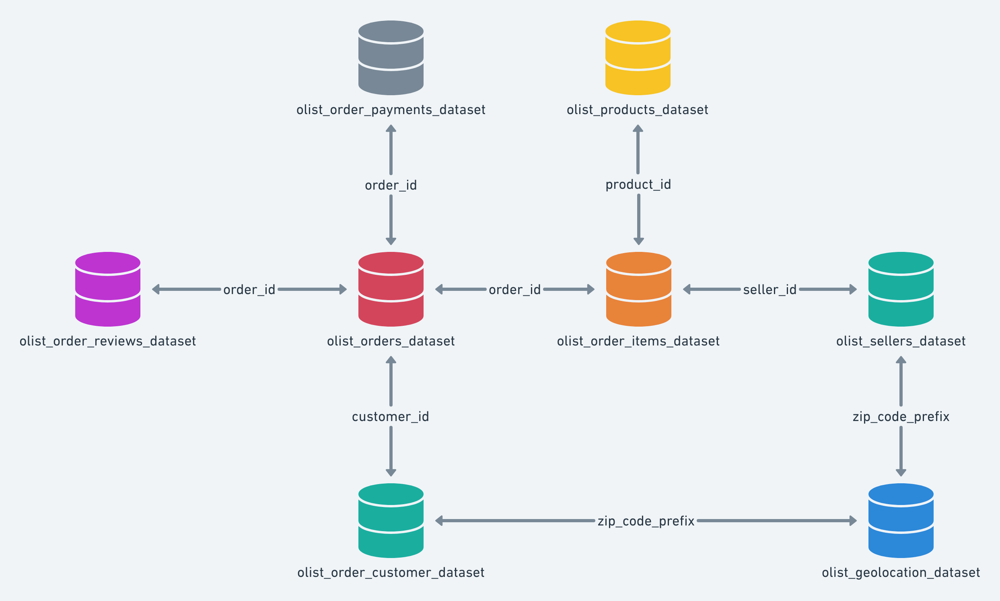

In [ ]:
Image(filename='/content/drive/MyDrive/Colab Notebooks/P5-Ecom /HRhd2Y0.png',width=800, height=400 )

In [ ]:
for column in df2.loc[:, 'order_purchase_timestamp':].columns:
  df2[column] = pd.to_datetime(df2[column])

df2.dtypes

order_id                                 object
customer_id                              object
order_status                             object
order_purchase_timestamp         datetime64[ns]
order_approved_at                datetime64[ns]
order_delivered_carrier_date     datetime64[ns]
order_delivered_customer_date    datetime64[ns]
order_estimated_delivery_date    datetime64[ns]
dtype: object

# 1. Data preparation

## Customers (customer_unique_id)

In [ ]:
print('\n************************Customer infos: unique id, adresse**************************')
print(df1.shape)
print(df1.head(0))

print('\n*****************************Customers geolocalisation******************************')
print(df9.shape)
print(df9.head(0))

print('\n*************************Homogenisation df9 & df1 indexes***************************')

df9X = df9.rename(columns ={'geolocation_zip_code_prefix' : 'customer_zip_code_prefix',
                             'geolocation_lat': 'latitude',
                             'geolocation_lng': 'longitude',
                             'geolocation_city' : 'customer_city',
                             'geolocation_state': 'customer_state'})
print(df9X.shape)
print(df9X.head(0))


************************Customer infos: unique id, adresse**************************
(99441, 5)
Empty DataFrame
Columns: [customer_id, customer_unique_id, customer_zip_code_prefix, customer_city, customer_state]
Index: []

*****************************Customers geolocalisation******************************
(1000163, 5)
Empty DataFrame
Columns: [geolocation_zip_code_prefix, geolocation_lat, geolocation_lng, geolocation_city, geolocation_state]
Index: []

*************************Homogenisation df9 & df1 indexes***************************
(1000163, 5)
Empty DataFrame
Columns: [customer_zip_code_prefix, latitude, longitude, customer_city, customer_state]
Index: []


#### Customers merging

In [ ]:
df_customers = pd.merge(df1, df9X, how="left" , on= ["customer_zip_code_prefix", "customer_city" , "customer_state"])
df_customers = df_customers.loc[~df_customers['customer_id'].duplicated(), ['customer_unique_id','customer_id', 'longitude', 'latitude']] 

print(f'Shape : {df_customers.shape}')
print(f'customer_unique_id: {len(df_customers["customer_unique_id"].unique())}')
print(f'customer_id: {len(df_customers["customer_id"].unique())}')
df_customers.head(0)

Shape : (99441, 4)
customer_unique_id: 96096
customer_id: 99441


,customer_unique_id,customer_id,longitude,latitude


## Orders (order_id)

In [ ]:
print('\n************Orders infos: costumer_id, purchasing/delivery dates DF****************')
print(df2.shape)
print(df2.head(0))

print('\n**********************************comments/ranking DF******************************')
print(df3.shape)
print(df3.head(0))

print('\n**********************************Payement DF******************************')
print(df4.shape)
print(df4.head(0))


************Orders infos: costumer_id, purchasing/delivery dates DF****************
(99441, 8)
Empty DataFrame
Columns: [order_id, customer_id, order_status, order_purchase_timestamp, order_approved_at, order_delivered_carrier_date, order_delivered_customer_date, order_estimated_delivery_date]
Index: []

**********************************comments/ranking DF******************************
(99224, 7)
Empty DataFrame
Columns: [review_id, order_id, review_score, review_comment_title, review_comment_message, review_creation_date, review_answer_timestamp]
Index: []

**********************************Payement DF******************************
(103886, 5)
Empty DataFrame
Columns: [order_id, payment_sequential, payment_type, payment_installments, payment_value]
Index: []


In [ ]:
df2X= df2.loc[:,'order_id':'order_purchase_timestamp']
df2X = df2X.drop("order_status", axis=1)

df2X['delivery_delay'] = (df2['order_delivered_customer_date']-df2['order_estimated_delivery_date']).dt.days
 
print(df2X.shape)
df2X.head(0)

(99441, 4)


,order_id,customer_id,order_purchase_timestamp,delivery_delay


In [ ]:
df3X = df3[["order_id", "review_score"]]
df3X = df3X.groupby('order_id').mean().reset_index()
print(df3X.shape)
df3X.head(0)

(98673, 2)


,order_id,review_score


In [ ]:
df4X = df4[["order_id", "payment_value", 'payment_installments']]

df4X = df4X.groupby('order_id').agg({"payment_value"        : 'sum',
                                     'payment_installments' : 'max'
                                     }).reset_index()
print(df4X.shape)
df4X.head(2)

(99440, 3)


,order_id,payment_value,payment_installments
0,00010242fe8c5a6d1ba2dd792cb16214,72.19,2
1,00018f77f2f0320c557190d7a144bdd3,259.83,3


#### Orders/Payement/Reviews Merging 

In [ ]:
df_orders = pd.merge(df2X, df3X, on='order_id', how='left')
df_orders = pd.merge(df_orders, df4X, on='order_id')

print(f'Shape : {df_orders.shape}')
print(f'order_id: {len(df_orders["order_id"].unique())}')
df_orders.head(0)

Shape : (99440, 7)
order_id: 99440


,order_id,customer_id,order_purchase_timestamp,delivery_delay,review_score,payment_value,payment_installments


## Products

In [ ]:
print('\n**********************************Order_id = fct(product_id, seller_id) DF******************************')
print(df5.shape)
print(df5.head(0))

print('\n********************************************Product description DF**************************************')
print(df6.shape)
print(df6.head(0))

print('\n******************************************Product name translation DF***********************************')
print(df7.shape)
print(df7.head(0))


**********************************Order_id = fct(product_id, seller_id) DF******************************
(112650, 7)
Empty DataFrame
Columns: [order_id, order_item_id, product_id, seller_id, shipping_limit_date, price, freight_value]
Index: []

********************************************Product description DF**************************************
(32951, 9)
Empty DataFrame
Columns: [product_id, product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g, product_length_cm, product_height_cm, product_width_cm]
Index: []

******************************************Product name translation DF***********************************
(71, 2)
Empty DataFrame
Columns: [product_category_name, product_category_name_english]
Index: []


In [ ]:
#Sellers infos: id, location
print(df8.shape)
df8.head(0)

(3095, 4)


,seller_id,seller_zip_code_prefix,seller_city,seller_state


### New product categories

In [ ]:
A=[1,0,0,0,0,0,0,0,0,0,0]
B=[0,1,0,0,0,0,0,0,0,0,0]
C=[0,0,1,0,0,0,0,0,0,0,0]
D=[0,0,0,1,0,0,0,0,0,0,0]
E=[0,0,0,0,1,0,0,0,0,0,0]
F=[0,0,0,0,0,1,0,0,0,0,0]
G=[0,0,0,0,0,0,1,0,0,0,0]
H=[0,0,0,0,0,0,0,1,0,0,0]
I=[0,0,0,0,0,0,0,0,1,0,0]
J=[0,0,0,0,0,0,0,0,0,1,0]
K=[0,0,0,0,0,0,0,0,0,0,1]
Beauty = { 'Class': 'A', 'List' : ["health_beauty", "perfumery", "fashion_sport"]}

Fashion= { 'Class': 'B', 'List' : ["fashion_underwear_beach", "fashio_female_clothing", "fashion_bags_accessories", "fashion_male_clothing",
           "luggage_accessories", "fashion_shoes"  ]}

DIY_Security= { 'Class': 'C', 'List' :["construction_tools_safety", "construction_tools_lights", "home_construction", "signaling_and_security","costruction_tools_tools",
              "costruction_tools_garden","garden_tools", "construction_tools_construction", "security_and_services" ]}

Home = { 'Class': 'D', 'List' : ["furniture_bedroom", "furniture_living_room",  "small_appliances_home_oven_and_coffee","home_comfort_2" ,"la_cuisine", "home_appliances_2",
         "home_confort", "housewares", "furniture_decor", "bed_bath_table", "small_appliances", "home_appliances", "air_conditioning", "cool_stuff",
        "kitchen_dining_laundry_garden_furniture", "furniture_mattress_and_upholstery"]}

Work = { 'Class': 'E', 'List' : ["industry_commerce_and_business", "stationery", "agro_industry_and_commerce", "office_furniture", "market_place"]}  #market_place !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

AudioVision= { 'Class': 'F', 'List' :["computers", "dvds_blu_ray", "cds_dvds_musicals", "cine_photo", "computers_accessories", "fixed_telephony",
             "tablets_printing_image", "telephony", "electronics", "audio"]}

FoodDrinks= { 'Class': 'G', 'List' : ["food", "drinks", "food_drink"]}

Entertainment = { 'Class': 'H', 'List' : ["books_general_interest", "books_technical", "books_imported", "sports_leisure", "consoles_games", 
                                         "pet_shop", "art", "musical_instruments", "arts_and_craftmanship", "music"]}

Celebration = { 'Class': 'I', 'List' : ["christmas_supplies", "flowers", "watches_gifts", "party_supplies" ]}

Kids = { 'Class': 'J', 'List' : ["diapers_and_hygiene", "baby", "toys", "fashion_childrens_clothes",]}

Auto= { 'Class': 'K', 'List' : [ "auto"]}

#Art_Music = { 'Class': 11, 'List' : ["art", "musical_instruments", "arts_and_craftmanship", "music"]}

Product_Categories = [Beauty, Fashion, DIY_Security, Home, Work, AudioVision, FoodDrinks, Celebration, Kids, Auto, Entertainment]

### Products merging

In [ ]:
df5X = df5.drop('shipping_limit_date', axis=1)   

df6X = pd.merge( df6[['product_id', 'product_category_name']], df7, on='product_category_name')

df6X = df6X.drop('product_category_name', axis= 1)

df_products = pd.merge(df5X, df6X, on = "product_id")
df_products["products_categories"] = df_products["product_category_name_english"].copy()
for cat in Product_Categories:
  df_products["products_categories"] = df_products["products_categories"].apply(lambda x: cat['Class'] if x in cat['List'] else x)


print(f'Shape : {df_products.shape}')
print(f'order_id: {len(df_products["order_id"].unique())}')
df_products.head(0)

Shape : (111023, 8)
order_id: 97256


,order_id,order_item_id,product_id,seller_id,price,freight_value,product_category_name_english,products_categories


## Merging

In [ ]:
df_orders = df_orders.drop_duplicates()
print(df_orders.shape)
df_orders.head(0)

(99440, 7)


,order_id,customer_id,order_purchase_timestamp,delivery_delay,review_score,payment_value,payment_installments


In [ ]:
df_customers = df_customers.drop_duplicates()
print(df_customers.shape)
df_customers.head(0)

(99441, 4)


,customer_unique_id,customer_id,longitude,latitude


In [ ]:
df_products = df_products.drop_duplicates()
print(df_products.shape)
df_products.head(0)

(111023, 8)


,order_id,order_item_id,product_id,seller_id,price,freight_value,product_category_name_english,products_categories


In [ ]:
df = pd.merge(df_customers , df_orders, on ="customer_id")
df = pd.merge(df, df_products , on ="order_id")

print(f'Shape : {df.shape}')
print(f'order_id: {len(df["order_id"].unique())}')
print(f'customer_id: {len(df["customer_id"].unique())}')
print(f'customer_unique_id: {len(df["customer_unique_id"].unique())}')
df.head(0)

Shape : (111020, 17)
order_id: 97255
customer_id: 97255
customer_unique_id: 94087


,customer_unique_id,customer_id,longitude,latitude,order_id,order_purchase_timestamp,delivery_delay,review_score,payment_value,payment_installments,order_item_id,product_id,seller_id,price,freight_value,product_category_name_english,products_categories


# 2. Features engineering 

In [ ]:
df = df.drop_duplicates()

In [ ]:
#************************************Create features*************************************************************
dfX = df.groupby(["customer_unique_id", 'longitude', 'latitude'], as_index=False).agg(                                                                     
                                                                      frequency               = ('order_id', 'nunique'),                             
                                                                      monetary                = ("payment_value", "sum"),                                                                      
                                                                      delivery_delay          = ('delivery_delay', 'mean'),
                                                                      score                   = ("review_score", "mean"),                                                                      
                                                                      n_payments              = ('payment_installments' , 'max'),                                     
                                                                      n_items                 = ('order_item_id','count'),
                                                                      n_sellers               = ('seller_id', 'count'),
                                                                      price                   = ('price','sum'),
                                                                      freight                 = ('freight_value','sum'),
                                                                      n_categories            = ("products_categories" , "nunique"),
                                                                      p_categories            = ("products_categories" , "unique"),
                                                                      recent_order            = ("order_purchase_timestamp", "max")                                                                  
                                                                     )             

dfX['freight_per'] = dfX['freight']/dfX['price']                                                                      

dfX["recency"] = (dfX['recent_order'].max() - dfX['recent_order']).dt.days                                         
                                        
print(dfX.shape)
dfX.sample(4)

(94042, 17)


,customer_unique_id,longitude,latitude,frequency,monetary,delivery_delay,score,n_payments,n_items,n_sellers,price,freight,n_categories,p_categories,recent_order,freight_per,recency
70450,bf664c530599b952bc4e98eb9b742fab,-40.279586,-20.331613,1,133.69,2.0,4.0,3,1,1,115.0,18.69,1,[I],2018-03-24 18:01:37,0.162522,162
43237,7573d3c7008f7374d3d2ad1ddcf591e9,-51.913860,-23.437975,1,152.10,-11.0,5.0,5,1,1,139.0,13.10,1,[I],2017-11-24 14:04:25,0.094245,282
45399,7b4a13609c466305540b6f4f416856b6,-46.777201,-23.530135,1,69.78,-10.0,4.0,1,1,1,62.0,7.78,1,[D],2018-03-02 08:27:39,0.125484,185
12953,2312111a663c6fe21d6068e7fe2d9672,-47.887058,-15.769515,1,48.79,-8.0,4.0,1,1,1,29.9,18.89,1,[D],2018-02-09 13:46:48,0.631773,205


In [ ]:
print(dfX['n_categories'].value_counts())
print(df['products_categories'].value_counts())
print(dfX['p_categories'].value_counts())

1    92491
2     1495
3       47
4        8
5        1
Name: n_categories, dtype: int64
D    33679
F    16203
H    13556
A    13116
J     7229
C     6920
I     6220
E     4999
K     4235
B     3696
G     1167
Name: products_categories, dtype: int64
[D]                26701
[F]                13779
[H]                11537
[A]                11445
[J]                 6420
[I]                 5547
[C]                 5220
[E]                 4081
[K]                 3726
[B]                 3135
[G]                  900
[A, F]                 1
[C, H]                 1
[C, D]                 1
[J, E]                 1
[F, D]                 1
[F, D]                 1
[H, D]                 1
[F, H]                 1
[H, F]                 1
[K, C]                 1
[A, D]                 1
[D, C]                 1
[B, D]                 1
[F, I]                 1
[F, E]                 1
[E, H]                 1
[C, J]                 1
[A, H]                 1
[E, B]                 1
[

In [ ]:
#************************************Customer frequency*************************************************************
#dfX['customer_frequency'] = np.zeros(shape = len(dfX['customer_period']))
#dfX.loc[dfX['customer_period'] > 0, 'customer_frequency'] = 1 #dfX['total_orders']/dfX['customer_period']
#dfX.loc[dfX['total_orders'] == 1, 'customer_frequency'] = 'NF'
#dfX.loc[dfX['total_orders'] > 1, 'customer_frequency'] = 'F' #dfX['total_orders']/dfX['customer_period']
#dfX.loc[dfX['total_orders'] > 5, 'customer_frequency'] = 'HF'

In [ ]:
dfX.isnull().sum()

customer_unique_id       0
longitude                0
latitude                 0
frequency                0
monetary                 0
delivery_delay        2015
score                  696
n_payments               0
n_items                  0
n_sellers                0
price                    0
freight                  0
n_categories             0
p_categories             0
recent_order             0
freight_per              0
recency                  0
dtype: int64

# 3. Data transformation

In [ ]:
non_num = ['customer_unique_id', 'recent_order', 'p_categories'] 
num_variables = dfX.loc[:, ~dfX.columns.isin(non_num) ].columns

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axe

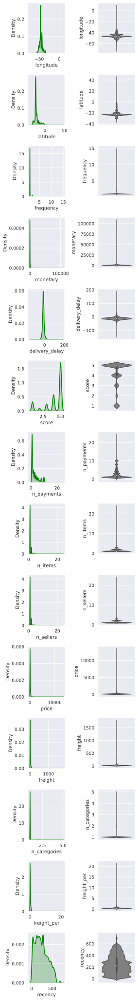

In [ ]:
sns.set(style="darkgrid")

fig, axs = plt.subplots(len(num_variables), 2, figsize=(5,35))
i=0

for column in num_variables:    

    sns.distplot(dfX[column], hist = False, kde=True, kde_kws = {'shade': True, 'linewidth': 2}, color= 'green' , ax=axs[i,0])
    sns.violinplot(y=dfX[column], data=dfX, color="gray", ax=axs[i,1])   


    i=i+1 

plt.show()

## Data positive

In [ ]:
df_XP = dfX.copy()

for column in num_variables:
  
  if (df_XP[column].min() <= 0.0) & (df_XP[column].max() > 0.0) : 
    df_XP[column] = df_XP[column] - df_XP[column].min() + df_XP[df_XP[column]>0][column].min()
  
  if df_XP[column].max() <= 0.0:
    df_XP[column] = df_XP[column] - df_XP[column].min() - df_XP[df_XP[column]<0][column].max()

In [ ]:
df_XP.isnull().sum()

customer_unique_id       0
longitude                0
latitude                 0
frequency                0
monetary                 0
delivery_delay        2015
score                  696
n_payments               0
n_items                  0
n_sellers                0
price                    0
freight                  0
n_categories             0
p_categories             0
recent_order             0
freight_per              0
recency                  0
dtype: int64

In [ ]:
df_XP.describe()

,longitude,latitude,frequency,monetary,delivery_delay,score,n_payments,n_items,n_sellers,price,freight,n_categories,freight_per,recency
count,94042.000000,94042.000000,94042.000000,94042.000000,92027.000000,93346.000000,94042.000000,94042.000000,94042.000000,94042.000000,94042.000000,94042.000000,94042.000000,94042.000000
mean,35.843369,15.432515,1.030912,212.508386,135.634240,4.104612,3.945375,1.176932,1.176932,142.095164,23.589064,1.017194,0.306488,246.178590
std,4.082774,5.651004,0.199934,642.904503,10.149665,1.325382,2.726949,0.614190,0.614190,217.132908,22.842645,0.136149,0.308621,153.206397
min,9.341528,0.004617,1.000000,9.590000,0.500000,1.000000,1.000000,1.000000,1.000000,0.850000,0.030000,1.000000,0.000252,4.000000
25%,33.904971,13.022027,1.000000,63.845000,130.500000,4.000000,2.000000,1.000000,1.000000,47.800000,14.080000,1.000000,0.132262,122.000000
50%,35.378334,13.684259,1.000000,112.810000,135.500000,5.000000,3.000000,1.000000,1.000000,89.500000,17.630000,1.000000,0.224340,227.000000
75%,38.419771,16.484914,1.000000,202.177500,140.500000,5.000000,5.000000,1.000000,1.000000,154.990000,25.500000,1.000000,0.378530,355.000000
max,91.349761,81.675925,15.000000,109312.640000,335.500000,5.000000,25.000000,24.000000,24.000000,13440.000000,1794.990000,5.000000,21.447311,732.000000


## Logarithm/ BoxCox

In [ ]:
BoxCox_list = ['longitude', 'latitude', 'monetary', 'n_payments', 'price', 'freight', 'freight_per', 'recency']
df_XB = df_XP.copy()
lmbdaS= []

for column in num_variables:    
    BoxCox_data, lmbda = stats.boxcox(df_XB[column])
    df_XB[column] = BoxCox_data
    lmbdaS.append(lmbda)
    print(f'{column} : {lmbda}')


longitude : 1.0134209640790461
latitude : 0.1364866622036453
frequency : -49.02295728262767
monetary : -0.2521656675740217
delivery_delay : 8.472135811722177
score : 8.472135811722177
n_payments : -1.0422161885249732
n_items : -9.699266540092912
n_sellers : -9.699266540092912
price : -0.08063214531879577
freight : 0.16187809570891737
n_categories : -85.44692905827192
freight_per : 0.19545747322183876
recency : 0.5251768086067525


## Normalization

In [ ]:
df_XN = df_XB.copy()

Normalization = ColumnTransformer([("Scal", StandardScaler(), num_variables)])

Normalized = pd.DataFrame(Normalization.fit_transform(df_XN), index= df_XN.index, columns = num_variables)

for column in num_variables:
    df_XN[column] = Normalized[column]

In [ ]:
df_XN.head(0)

,customer_unique_id,longitude,latitude,frequency,monetary,delivery_delay,score,n_payments,n_items,n_sellers,price,freight,n_categories,p_categories,recent_order,freight_per,recency


## Distribution

In [ ]:
plt.rcParams["figure.figsize"] = [15, 7]
plt.rcParams["figure.autolayout"] = True

ax = df_XN.plot(kind='box', title='Features boxplot')
ax.set_ylim(-15,15)
plt.show()

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axe

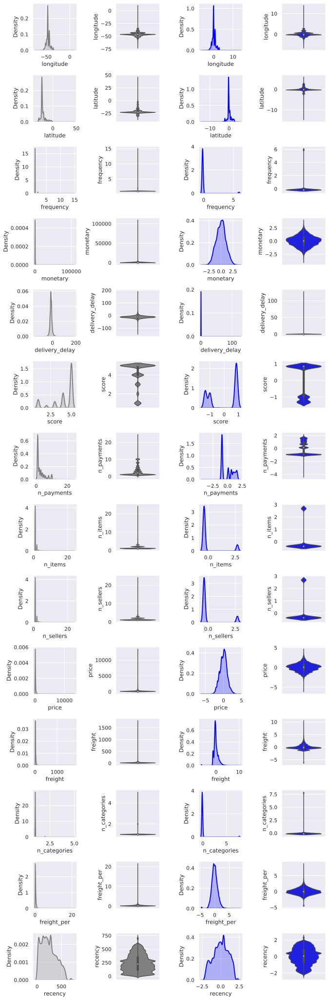

In [ ]:
sns.set(style="darkgrid")

fig, axs = plt.subplots(len(num_variables), 4, figsize=(10,30))
i=0

for column in num_variables:    

    sns.distplot(dfX[column], hist = False, kde=True, kde_kws = {'shade': True, 'linewidth': 2}, color="gray" , ax=axs[i,0])
    sns.violinplot(y=dfX[column], data=dfX, color="gray", ax=axs[i,1])   
    sns.distplot(df_XN[column], hist = False, kde=True, kde_kws = {'shade': True, 'linewidth': 2}, color="blue" , ax=axs[i,2])
    sns.violinplot(y=df_XN[column], data=df_XN, color="blue", ax=axs[i,3])

    i=i+1 

plt.show()

In [ ]:
df_XN.describe() 

,longitude,latitude,frequency,monetary,delivery_delay,score,n_payments,n_items,n_sellers,price,freight,n_categories,freight_per,recency
count,9.404200e+04,9.404200e+04,9.404200e+04,9.404200e+04,9.202700e+04,9.334600e+04,9.404200e+04,9.404200e+04,9.404200e+04,9.404200e+04,9.404200e+04,9.404200e+04,9.404200e+04,9.404200e+04
mean,9.090507e-16,-1.328990e-15,2.568900e-17,7.147588e-16,6.176820e-19,2.101652e-16,6.045227e-16,-1.110672e-16,-1.110672e-16,-2.163165e-16,-2.172232e-16,4.624021e-17,2.936858e-16,1.855653e-16
std,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00
min,-6.446965e+00,-1.453581e+01,-1.691879e-01,-3.931413e+00,-8.819546e-02,-1.324989e+00,-4.259444e+00,-3.728530e-01,-3.728530e-01,-5.968240e+00,-6.246567e+00,-1.294959e-01,-4.465845e+00,-2.378449e+00
25%,-4.754179e-01,-3.543920e-01,-1.691879e-01,-6.806092e-01,-4.551601e-02,-9.965032e-01,-9.538797e-01,-3.728530e-01,-3.728530e-01,-6.227061e-01,-5.032152e-01,-1.294959e-01,-6.377442e-01,-7.222732e-01
50%,-1.146746e-01,-2.088392e-01,-1.691879e-01,2.861453e-02,-2.950622e-02,8.504873e-01,1.215095e-01,-3.728530e-01,-3.728530e-01,6.397082e-02,-1.655843e-01,-1.294959e-01,-4.780444e-02,4.349216e-02
75%,6.306308e-01,3.464038e-01,-1.691879e-01,6.572237e-01,-8.417167e-03,8.504873e-01,9.656318e-01,-3.728530e-01,-3.728530e-01,6.372932e-01,4.159695e-01,-1.294959e-01,5.994915e-01,7.719522e-01
max,1.369477e+01,5.747838e+00,5.910587e+00,3.811933e+00,1.271125e+02,8.504873e-01,1.942003e+00,2.684821e+00,2.684821e+00,4.464439e+00,1.035336e+01,7.722250e+00,8.600107e+00,2.381140e+00


In [ ]:
df_XN.isnull().sum()

customer_unique_id       0
longitude                0
latitude                 0
frequency                0
monetary                 0
delivery_delay        2015
score                  696
n_payments               0
n_items                  0
n_sellers                0
price                    0
freight                  0
n_categories             0
p_categories             0
recent_order             0
freight_per              0
recency                  0
dtype: int64

# 4. Multivariate analysis

In [ ]:
fig = go.Figure()


fig.add_trace(go.Scattergeo(
        locationmode = 'country names',
        lon = dfX["longitude"],
        lat = dfX["latitude"],
        text = '({},{})'.format(dfX["longitude"], dfX["latitude"]),
        marker = dict(
            #size = dfX['delivery_delay'],
            color = dfX["freight_per"],
            line_color='rgb(40,40,40)',
            line_width=0.5,
            sizemode = 'area'
        ),
        name = 'Olist customers'))

fig.update_layout(
        title_text = 'Olist customers localisation map',
        showlegend = True,
        geo = dict(
            landcolor = 'rgb(217, 217, 217)',
        )
    )

fig.show()

In [ ]:
df_XN.plot(kind="scatter", x="longitude", y="latitude", figsize=(10,7) , alpha=1
        ,s=df_XN['delivery_delay']*20, label='delivery_delay'        
        ,c="freight_per", cmap=plt.get_cmap('tab20'), colorbar=True
       ) 
plt.xlim(-7,4)
plt.ylim(-5,5)
plt.legend()
plt.show()

/usr/local/lib/python3.7/dist-packages/matplotlib/collections.py:885: RuntimeWarning:

invalid value encountered in sqrt



In [ ]:
ax = df_XN.plot(kind="scatter", x="longitude", y="latitude", figsize=(10,7) , alpha=1
        ,s=df_XN['recency']*20, label="recency"        
        ,c="monetary", cmap=plt.get_cmap('jet'), colorbar=True
       )
plt.xlim(-7,4)
plt.ylim(-5,5)
plt.legend()
plt.show()

In [ ]:
plt.figure(figsize=(15, 10))
ax = sns.heatmap(
    dfX.corr(), 
    vmin=-1, vmax=1, center=0,
    cmap='BrBG',
    square=True,
    annot = True,
    annot_kws={"size": 5})

ax.set_title('Variables Correlation', fontdict={'fontsize':12}, pad=8);

ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=90,
    horizontalalignment='right')

# Data laoding to CSV

In [ ]:
df_XN.head(1)

In [ ]:
Path1 = '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /P5-Maintenance_Frequency.csv'
Path2 = '/content/drive/MyDrive/Colab Notebooks/P5-Ecom /P5-Transformer_data.csv'

df.to_csv(path_or_buf = Path1, index_label = 'index')
df_XN.to_csv(path_or_buf = Path2, index_label = 'index')